In [1]:
import pandas as pd
import numpy as np
from pathlib import Path
import plotly.express as px
import mlflow

In [2]:
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel
from sklearn.preprocessing import StandardScaler

In [3]:
import sys
sys.path.append("/Users/ryusuke/Downloads/study/data_competition/nishika_金融時系列予測/NishikaFinancialPrediction/src")
from metrics.metrics import cosine_similarity

# 環境設定

In [4]:
DATA_PATH = "../data"
RESULT_PATH = "../results"

# 関数定義

In [5]:
def count_feature_xs(df, feature_x: str):
    return len([col for col in df.columns if feature_x in col])

# 分析

## データ読み込み

In [100]:
train_data = pd.read_parquet(Path(DATA_PATH, "train.parquet"))
test_data = pd.read_parquet(Path(DATA_PATH, "test.parquet"))

## EDA

### 概要

In [101]:
train_data.head()

,id,feature_a_000,feature_a_001,feature_a_002,feature_a_003,feature_a_004,feature_a_005,feature_a_006,feature_a_007,feature_a_008,...,feature_d_131,feature_d_132,feature_d_133,feature_d_134,feature_f_000,feature_f_001,feature_f_002,feature_f_003,feature_f_004,target
0,0,4,5,4,5,5,1,3,1,4,...,4,2,3,2,4,2,4,1,4,0.000415
1,1,5,4,5,4,5,3,2,3,3,...,3,1,2,1,5,1,3,1,3,0.000415
2,2,1,1,5,1,2,1,1,3,1,...,4,4,3,2,1,2,3,1,3,3.039352
3,3,5,3,4,5,4,5,5,2,3,...,2,1,3,2,3,4,2,4,2,-0.512833
4,4,1,4,1,4,2,1,1,1,2,...,2,3,2,4,2,5,1,5,1,0.000415


In [106]:
print(f"学習データのshape：{train_data.shape}")
print(f"ユニークID数：{train_data['id'].nunique()}")
feature_xs = ["feature_a", "feature_b", "feature_c", "feature_d", "feature_e", "feature_f"]
for feature_x in feature_xs:
    print(f'{feature_x}の個数：{count_feature_xs(train_data, feature_x)}')
print(f"targetのユニークな要素数：{train_data['target'].nunique()}")
df_ = train_data.drop(columns="id")
print(f"学習データの重複：{len(df_[df_.duplicated()])}")

学習データのshape：(660000, 697)
ユニークID数：660000
feature_aの個数：285
feature_bの個数：135
feature_cの個数：135
feature_dの個数：135
feature_eの個数：0
feature_fの個数：5
targetのユニークな要素数：10
学習データの重複：0


In [110]:
print("1〜5のうち欠けている数値がある特徴量")
for col in train_data.drop(columns=["id", "target"]).columns:
    num = train_data[col].nunique()
    if num!=5:
        print(f"{col}: {train_data[col].unique()}")

1〜5のうち欠けている数値がある特徴量
feature_a_249: [3 5 1 4]
feature_a_251: [3 5 1 4]


In [9]:
print(f"学習データのshape：{test_data.shape}")
print(f"ユニークID数：{test_data['id'].nunique()}")
feature_xs = ["feature_a", "feature_b", "feature_c", "feature_d", "feature_e", "feature_f"]
for feature_x in feature_xs:
    print(f'{feature_x}の個数：{count_feature_xs(train_data, feature_x)}')
print(f"trainデータとtestデータのid被り:{len(set(train_data['id']) & set(test_data['id']))}")

学習データのshape：(261661, 696)
ユニークID数：261661
feature_aの個数：285
feature_bの個数：135
feature_cの個数：135
feature_dの個数：135
feature_eの個数：0
feature_fの個数：5
trainデータとtestデータのid被り:0


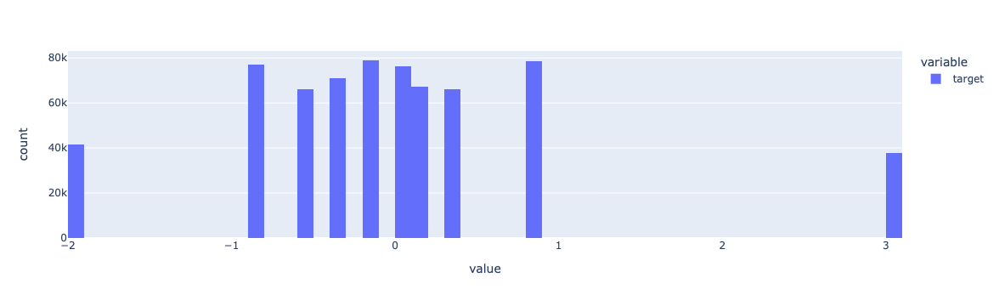

In [57]:
fig = px.histogram(train_data["target"])
fig.show()

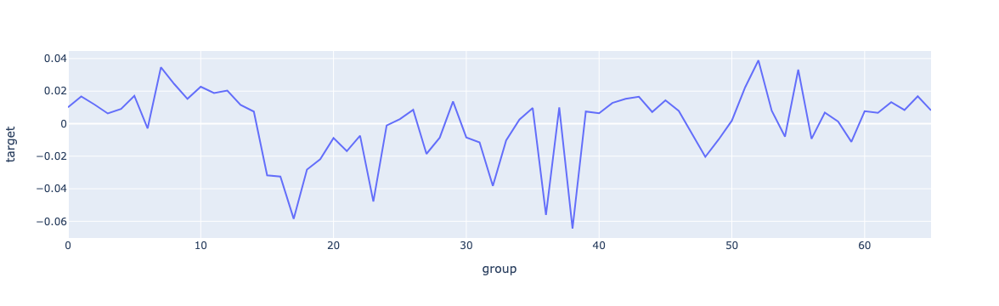

In [111]:
train_data["group"] = train_data["id"].apply(lambda x: x//10000)
train_data_for_plot = train_data[['group', 'target']].groupby('group').mean().reset_index()
px.line(train_data_for_plot, x='group', y='target')

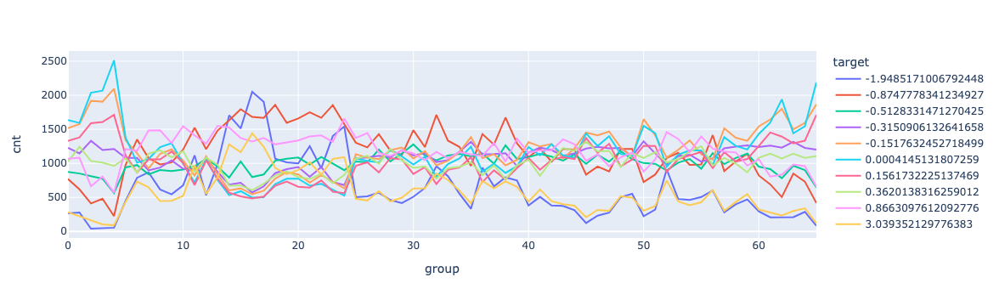

In [125]:
# 10種のtargetそれぞれの時系列的推移を確認
train_data_for_plot = train_data.groupby(["group", "target"]).size().reset_index().rename(columns={0: "cnt"})
px.line(train_data_for_plot, "group", "cnt", color="target")

### 欠損値

In [12]:
print(f"欠損値を含む列数(train data): {sum(train_data.isnull().any())}")
print(f"欠損値を含む列数(test data): {sum(test_data.isnull().any())}")

欠損値を含む列数(train data): 0
欠損値を含む列数(test data): 0


### 相関

In [13]:
corr_dict = {}
for col in train_data.columns:
    corr_dict[col] = train_data[col].corr(train_data["target"])

In [14]:
sorted(corr_dict.items(), reverse=True, key=lambda x: abs(x[1]))[0:10]

[('target', 1.0),
 ('feature_c_053', 0.028239860124998722),
 ('feature_c_058', -0.02821379235516259),
 ('feature_a_175', 0.028065580987960338),
 ('feature_c_108', 0.02754742276484269),
 ('feature_a_176', 0.02739780652847868),
 ('feature_a_177', 0.027333472073270484),
 ('feature_c_061', 0.026228682551452196),
 ('feature_c_051', 0.02573018306080225),
 ('feature_c_106', 0.02521556774475346)]

### Lasso

In [36]:
target_col = "target"
feature_cols = train_data.drop(columns=target_col).columns
X_train, X_eval, y_train, y_eval = train_test_split(
    train_data[feature_cols],
    train_data[target_col],
    test_size=0.3,
    shuffle=True,
)

In [49]:
# 標準化
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
# 学習
model = Lasso(alpha=0.01)
model.fit(X_train_scaled, y_train)
# 予測
y_eval_pred = model.predict(scaler.transform(X_eval))
print(cosine_similarity(y_eval, y_eval_pred))

0.05042910134803199


In [51]:
# 係数が0でない特徴量
important_features = feature_cols[np.nonzero(model.coef_)]
for feature in important_features:
    print(f"{feature}: {corr_dict[feature]}")

feature_a_036: 0.01885962094182499
feature_a_040: 0.01937836402866875
feature_a_050: -0.00793326516144117
feature_a_053: 0.0217452658299531
feature_a_058: 0.021946986516206336
feature_a_070: 0.018254769643723488
feature_a_147: -0.021058203984906217
feature_a_175: 0.028065580987960338
feature_a_176: 0.02739780652847868
feature_a_274: 0.01829171300311012
feature_a_276: 0.020019287562005182
feature_b_085: 0.024890445244283223
feature_b_088: 0.015554536727259403
feature_c_053: 0.028239860124998722
feature_c_058: -0.02821379235516259
feature_c_088: 0.015441922400366414
feature_c_125: 0.020184411389754162
feature_c_130: 0.021053882500275622
feature_d_085: 0.025187444182192945


### lightgbm

In [96]:
# n_estimators=10のモデルだから，信用はできないのでちゃんと見たい場合モデルを変えること
model = mlflow.lightgbm.load_model("../mlflow/artifacts/a9292de9a6cb4902a807c04479390f71/artifacts/model")

<AxesSubplot:>

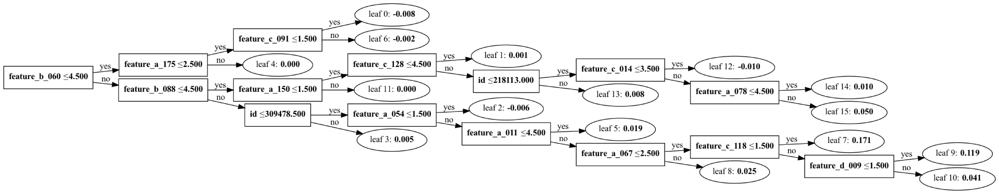

In [98]:
# tree_indexがどの決定木かという話だと思うが，何個あるのだろう？？(0〜9まであるぽい)
lgb.plot_tree(model, figsize=(100 ,50), tree_index=1)

<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

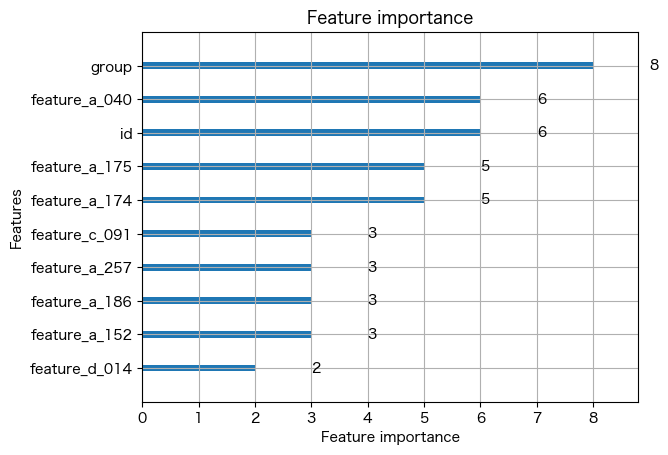

In [20]:
lgb.plot_importance(model, importance_type="split" , max_num_features=10)

<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

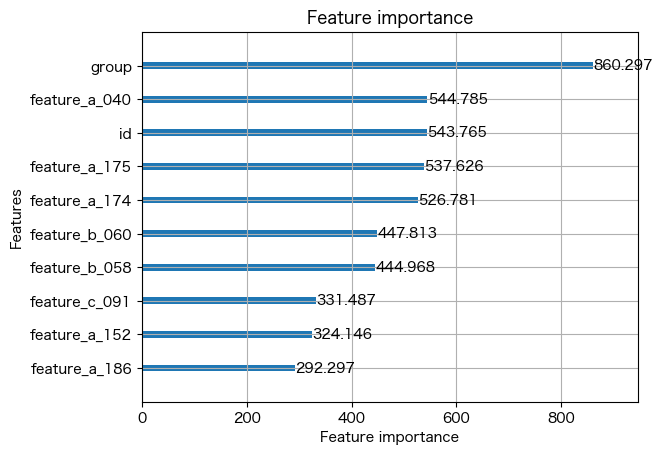

In [21]:
lgb.plot_importance(model, importance_type="gain" , max_num_features=10)